Load libraries

In [6]:
from ma_mapper import mapper
from ma_mapper import plots
from ma_mapper import custom_cmap

### Initial Parameters

In [3]:
alignment_filepath = '/rds/project/rds-XrHDlpCeVDg/users/pakkanan/data/output/ma_mapper/hg38_main/alignment/THE1C.fasta.aligned'
AP1_motif_data_filepath = '/rds/project/rds-XrHDlpCeVDg/users/pakkanan/data/resource/annotation/homer_known_motif_hg38/AP-1(bZIP).bed'
NFkB_motif_data_filepath = '/rds/project/rds-XrHDlpCeVDg/users/pakkanan/data/resource/annotation/homer_known_motif_hg38/NFkB-p65(RHD).bed'
phyloP_data_filepath = '/rds/project/rds-XrHDlpCeVDg/users/pakkanan/data/resource/UCSC_phyloP_track/hg38.phyloP447way.bw'

Extract genomewide data into data matrix using coordinates and alignment structure from the alignment file 

In [4]:
ap1_matrix=mapper.map_and_overlay(alignment_filepath, AP1_motif_data_filepath,data_format='bed')
nfkb_matrix=mapper.map_and_overlay(alignment_filepath, NFkB_motif_data_filepath,data_format='bed')
phyloP_matrix = mapper.map_and_overlay(alignment_filepath, phyloP_data_filepath, data_format='bigwig')

2025-03-29 23:28:03,213 INFO: parse alignment


2025-03-29 23:28:11,050 INFO: extract from bed file: /rds/project/rds-XrHDlpCeVDg/users/pakkanan/data/resource/annotation/homer_known_motif_hg38/AP-1(bZIP).bed
2025-03-29 23:28:52,823 INFO: done, returning bed_out as object
2025-03-29 23:28:53,042 INFO: {<class 'numpy.float64'>}
2025-03-29 23:28:53,044 INFO: nested_data:False
2025-03-29 23:28:53,729 INFO: parse alignment
2025-03-29 23:28:59,871 INFO: extract from bed file: /rds/project/rds-XrHDlpCeVDg/users/pakkanan/data/resource/annotation/homer_known_motif_hg38/NFkB-p65(RHD).bed
2025-03-29 23:29:44,830 INFO: done, returning bed_out as object
2025-03-29 23:29:45,041 INFO: {<class 'numpy.float64'>}
2025-03-29 23:29:45,043 INFO: nested_data:False
2025-03-29 23:29:45,749 INFO: parse alignment
2025-03-29 23:32:05,599 INFO: done, returning bigwig_out as object
2025-03-29 23:32:05,826 INFO: {<class 'numpy.float32'>}
2025-03-29 23:32:05,828 INFO: nested_data:False


In [23]:
ap1_matrix

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [5]:
nfkb_matrix

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [10]:
phyloP_matrix

array([[-0.41499999,  0.88099998,  0.81400001, ..., -0.954     ,
        -0.33700001,  0.815     ],
       [-0.41499999,  0.88099998,  0.81400001, ..., -0.954     ,
        -0.33700001,  0.815     ],
       [-0.41499999,  0.88099998,  0.81400001, ..., -0.954     ,
        -0.33700001,  0.815     ],
       ...,
       [ 0.003     , -0.34999999,  0.80900002, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.76099998, ...,  0.81699997,
         0.048     ,  0.81699997],
       [ 0.38      ,  0.40799999,  0.40799999, ...,  0.2       ,
         0.        ,  0.        ]])

# PLOT CONFIGURATION
The plots module is a matplotlib wrapper that offer a certain degree of quick configuration for mapped alignment visualization

plot() is the wrapper of functions in this module. At basic level, this function should be enough for data plotting and customization

## heatmap customization
As the output from mapper module is matrix, one of the best way to visualize it is using matplotlib.heatmap, so this module would play around heatmap plot

Here is the most basic form of heatmap:

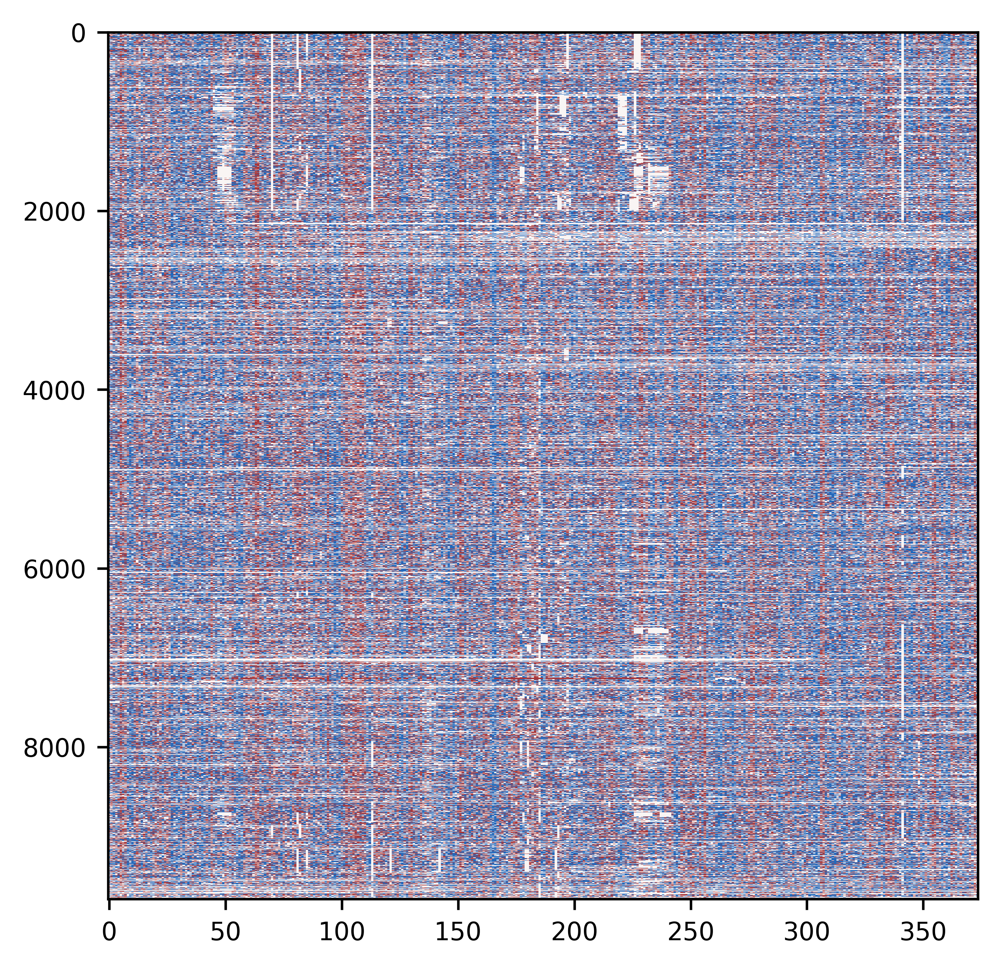

In [7]:
plots.plot(
    data=[phyloP_matrix], #data matrix
    heatmap_color=[custom_cmap.vlag_r_mpl], #colormap for the heatmap
    vlim =[[-0.5,0.5]]) #data value caps

It is possible to change colormap

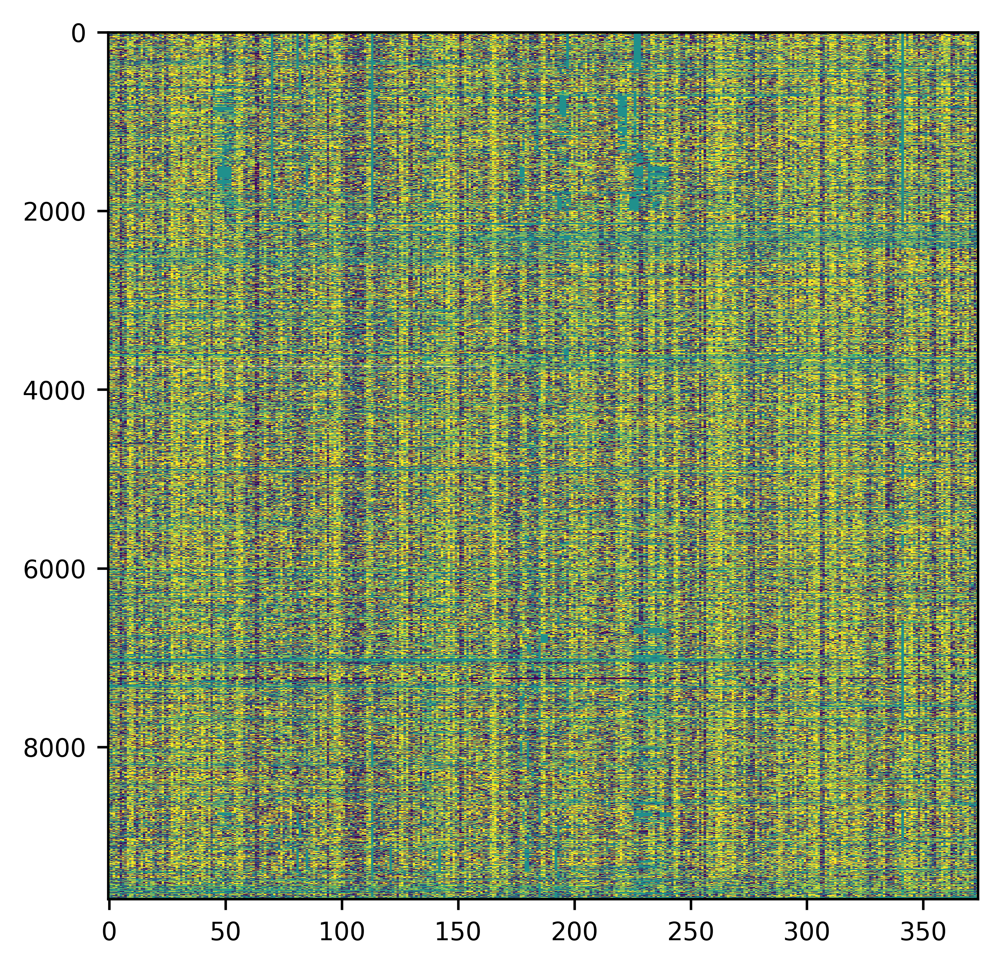

In [8]:
plots.plot(
    data=[phyloP_matrix], 
    heatmap_color=["viridis"], 
    vlim =[[-0.5,0.5]],
    )

There might be some data that need to be shown with alignment gap for visual/context clarity, there are specific functions to handle alignment plot

In [7]:
alignment_matrix, coordinate_table=mapper.parse_and_filter(alignment_filepath)

2025-03-30 02:01:27,897 INFO: parse alignment


In [10]:
alignment_matrix

array([[3., 4., 1., ..., 1., 2., 1.],
       [3., 4., 1., ..., 1., 2., 1.],
       [3., 4., 1., ..., 1., 2., 1.],
       ...,
       [3., 4., 1., ..., 0., 0., 0.],
       [0., 0., 1., ..., 1., 2., 1.],
       [3., 4., 2., ..., 1., 0., 0.]])

In [9]:
coordinate_table.iloc[0:10]

,chrom,start,end,name,score,strand,original_order
0,chr1,119563,119944,THE1C_0,20,-,0
1,chr1,296133,296514,THE1C_1,20,-,1
2,chr1,710552,710933,THE1C_2,20,-,2
3,chr19,181416,181797,THE1C_3502,20,-,3
4,chr9,138295330,138295711,THE1C_9041,20,+,4
5,chr11,111803,112184,THE1C_1008,20,-,5
6,chr16,90186983,90187364,THE1C_3026,20,+,6
7,chr8,190929,191310,THE1C_8163,20,-,7
8,chr20,64304133,64304514,THE1C_4559,20,+,8
9,chr6,130749,131130,THE1C_6966,20,-,9


Alignment plot

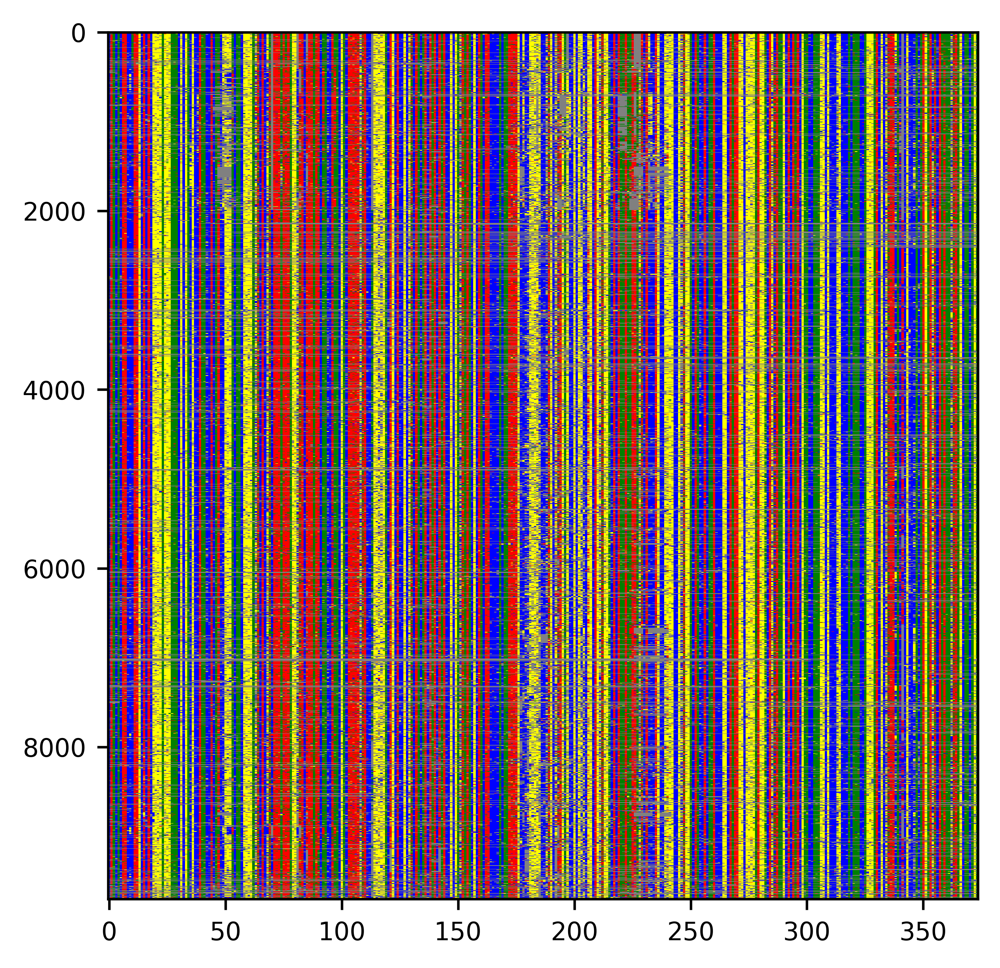

In [12]:
plots.plot(
    show_alignment=True,
    alignment=alignment_matrix, 
    alignment_col='dna', # color coding for dna
    )

In some context, we only need to see the gaps

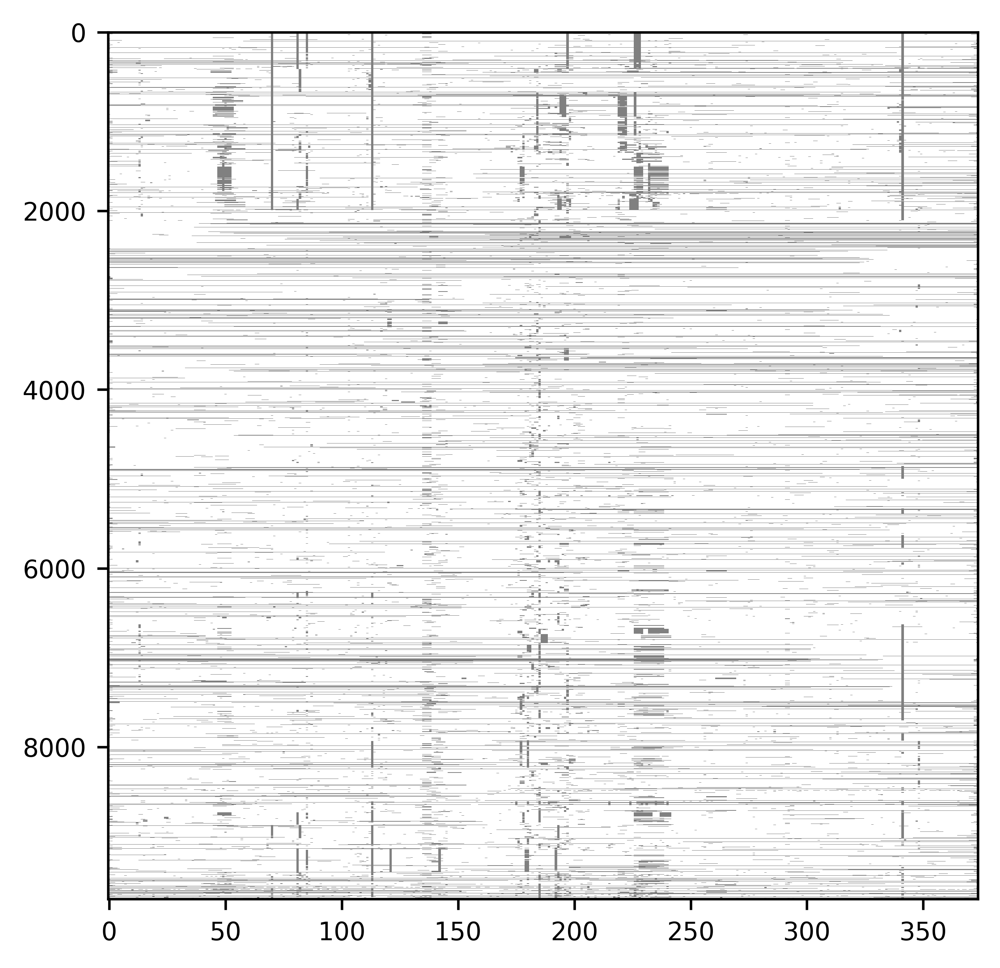

In [13]:
plots.plot(
    show_alignment=True,
    alignment=alignment_matrix, 
    alignment_col='nulc_white', 
    )

We can also add colorbars for both heatmap and alignment

0


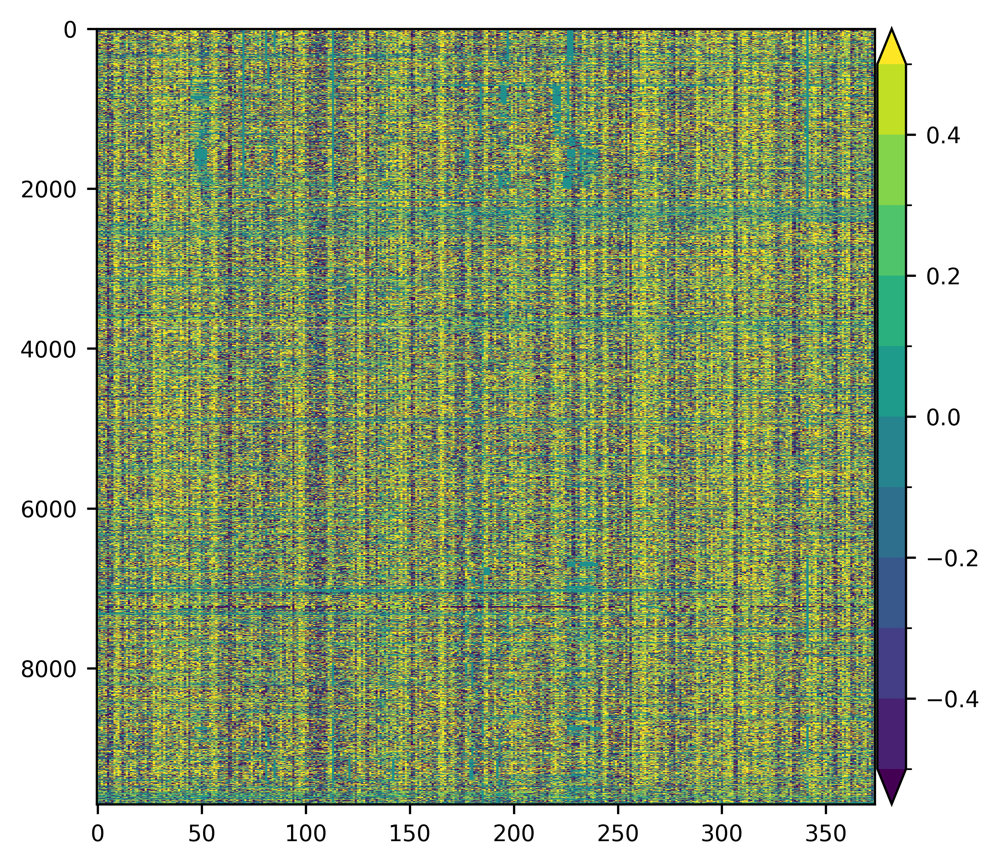

In [14]:
plots.plot(
    data=[phyloP_matrix], 
    heatmap_color=["viridis"], 
    vlim =[[-0.5,0.5]],
    colorbar = True, #enable colorbar
    colorbar_steps = [0.1], #control colorbar scale
    )

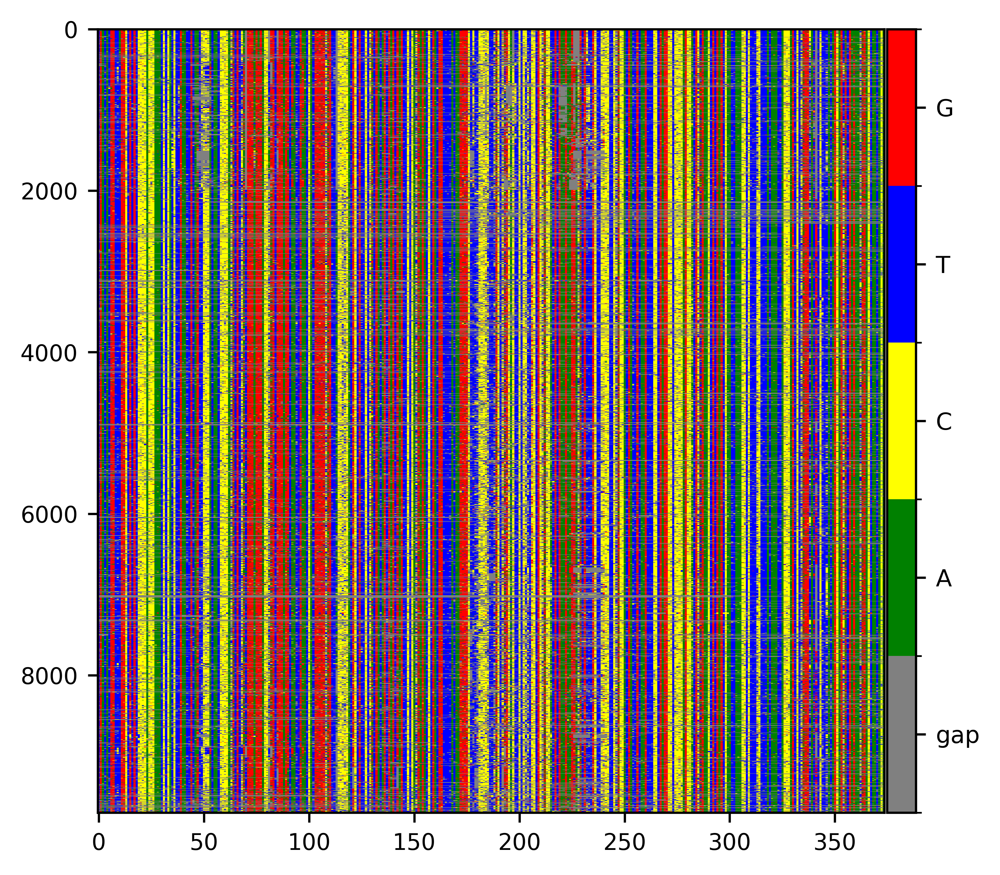

In [15]:
plots.plot(
    show_alignment=True,
    alignment=alignment_matrix, 
    alignment_col='dna',
    colorbar = True,
    show_alignment_colbar=True 
    )


Similar to data overlay, we can overlay data over alignment

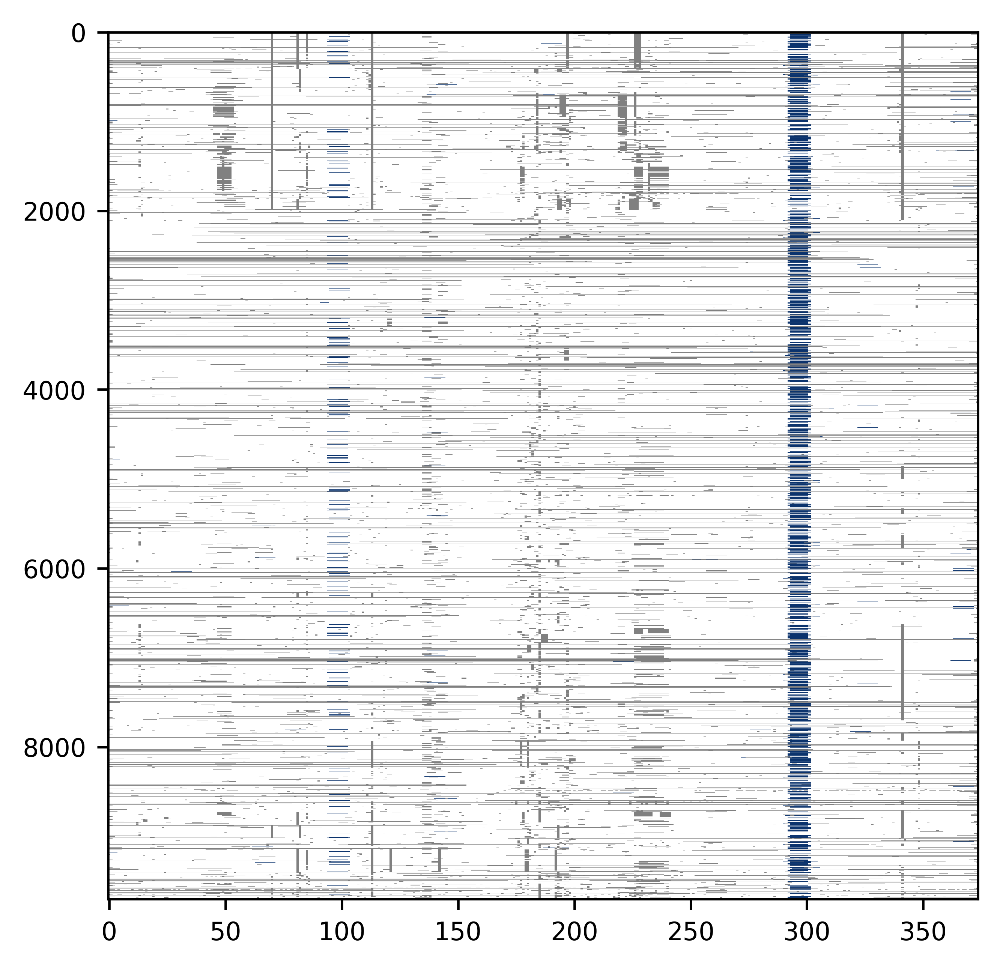

In [16]:
plots.plot(
    data=[ap1_matrix], 
    heatmap_color=["Blues"], 
    vlim =[[0,5]],
    opacity=0.99, #transparency value of heatmap layer
    show_alignment=True,
    alignment=alignment_matrix, 
    alignment_col='nulc_white', 
    )

Title, x-, y- axis label can be added 

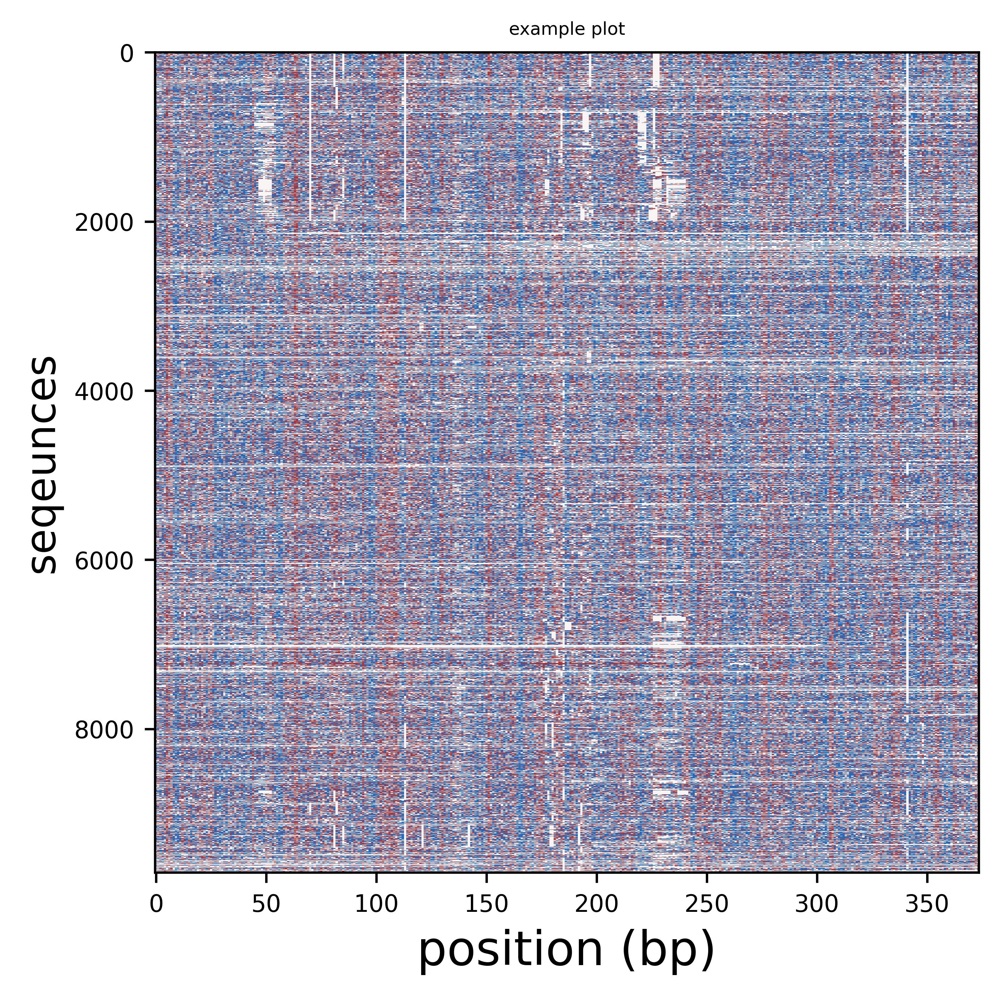

In [17]:
plots.plot(
    data=[phyloP_matrix], 
    heatmap_color=[custom_cmap.vlag_r_mpl], 
    vlim =[[-0.5,0.5]],
    heatmap_title=['example plot'],
    heatmap_title_fs=6, #font size
    heatmap_ylabel='seqeunces',
    heatmap_ylabel_fs=14,
    heatmap_xlabel='position (bp)',
    heatmap_xlabel_fs=16,
    ) 

Also, a certain area of the plot an be highlighted

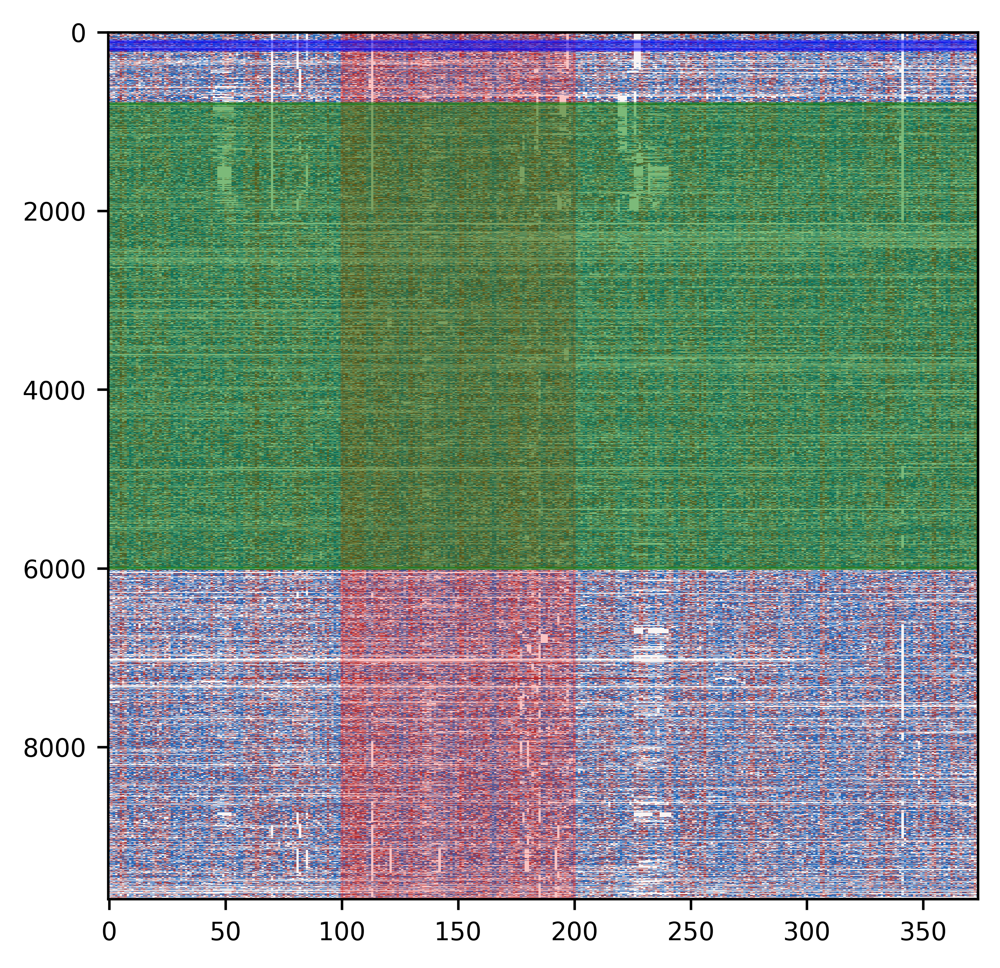

In [18]:
plots.plot(
    data=[phyloP_matrix], 
    heatmap_color=[custom_cmap.vlag_r_mpl], 
    vlim =[[-0.5,0.5]],
    heatmap_yhighlight= [[100,200]],#cooridnates
    heatmap_yhighlight_col= ['red'], #highlight color
    heatmap_yhighlight_alpha = [0.2], #transparent value
    heatmap_xhighlight = [[100,200],[6000,800]],
    heatmap_xhighlight_col = ['blue','green'],
    heatmap_xhighlight_alpha = [0.5,0.5],
    )

## Aggregated plot
this part was intended to show aggregated data from the main plot by normalizing the matrix by column and plot a resulting array as a bar chart

Calculate mean

In [12]:
mean_phyloP=mapper.normalise(alignment_matrix=alignment_matrix, data_matrix=phyloP_matrix, method = 'average')

In [14]:
mean_phyloP[0:10]

array([ 0.05160621, -0.09213803,  0.09364115,  0.00568707,  0.00229937,
       -1.03118748, -0.27442202, -0.24323896,  0.21823469,  0.29631333])

Here is the most basic aggregated plot

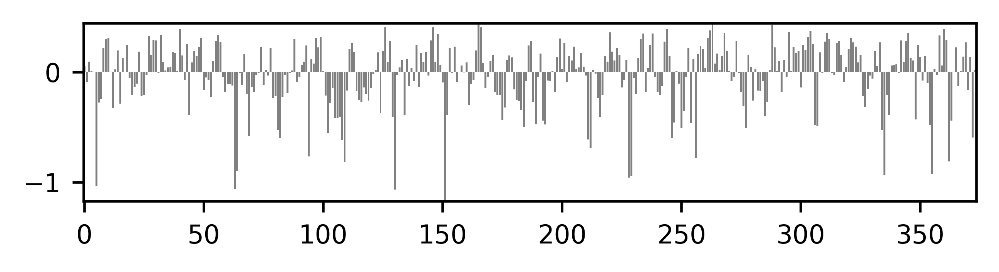

In [21]:
plots.plot(
    heatmap=False,
    aggregated_data=[mean_phyloP], 
    aggregated=True,
    agg_colset=['grey'])

Same as the heatmap, it is possible to change plot color

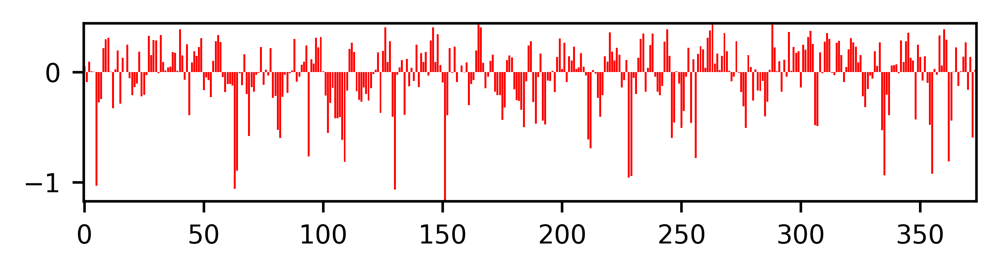

In [22]:
plots.plot(
    heatmap=False,
    aggregated_data=[mean_phyloP], 
    aggregated=True,
    agg_colset=['red'])

Title, x-, y- axis label can be added 

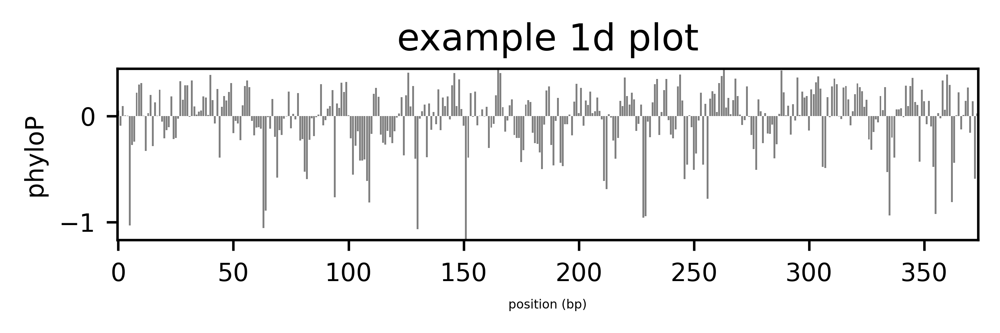

In [25]:
plots.plot(
    heatmap=False,
    aggregated_data=[mean_phyloP], 
    aggregated=True,
    agg_colset=['grey'],
    agg_plot_title=['example 1d plot'],
    agg_plot_title_fs=12,
    agg_xlabel='position (bp)',
    agg_xlabel_fs=4,
    agg_ylabel=['phyloP'],
    agg_ylabel_fs=8)

Also a certain area of the plot an be highlighted

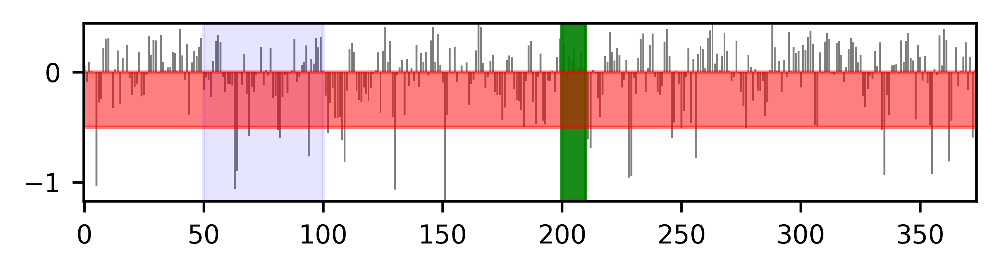

In [26]:
plots.plot(
    heatmap=False,
    aggregated_data=[mean_phyloP], 
    aggregated=True,
    agg_colset=['grey'],
    agg_xhighlight=[[-0.5,0]],
    agg_xhighlight_col=['red'],
    agg_xhighlight_alpha=[0.5],
    agg_yhighlight=[[50,100],[200,210]],
    agg_yhighlight_col=['blue','green'],
    agg_yhighlight_alpha=[0.1,0.9])

## Annotation configuration
The annotation and annotatin colorbar can be modified to a certain degree.

Genomewide data can be used to sort data matrix.

Calculate AP-1 coverage

In [24]:
ap1_coverage_array=mapper.normalise(alignment_matrix=alignment_matrix, data_matrix=ap1_matrix, method='perc_coverage')

In [25]:
ap1_coverage_array[0:10]

array([0.16900676, 0.13803489, 0.13053281, 0.12921414, 0.09326183,
       0.06956522, 0.06946857, 0.06916427, 0.06916427, 0.05747126])

Since the coordinate table was filtered in parse and filter function, reset index to match positions in output matrices

In [26]:
coordinate_table = coordinate_table.reset_index()

In [27]:
coordinate_table.iloc[0:10]

,index,chrom,start,end,name,score,strand,original_order
0,0,chr1,119563,119944,THE1C_0,20,-,0
1,1,chr1,296133,296514,THE1C_1,20,-,1
2,2,chr1,710552,710933,THE1C_2,20,-,2
3,3,chr19,181416,181797,THE1C_3502,20,-,3
4,4,chr9,138295330,138295711,THE1C_9041,20,+,4
5,5,chr11,111803,112184,THE1C_1008,20,-,5
6,6,chr16,90186983,90187364,THE1C_3026,20,+,6
7,7,chr8,190929,191310,THE1C_8163,20,-,7
8,8,chr20,64304133,64304514,THE1C_4559,20,+,8
9,9,chr6,130749,131130,THE1C_6966,20,-,9


Find peaks of coverage

In [31]:
import scipy
peaks, _ = scipy.signal.find_peaks(ap1_coverage_array, width = 6)

In [32]:
peaks

array([ 28,  70,  76,  97, 113, 138, 180, 188, 225, 294, 326, 370])

Find row indices

In [33]:
import numpy as np
index_of_rows_with_ap1 = np.unique(np.where(ap1_matrix[:, peaks] != 0)[0])
index_of_rows_without_ap1=list(set(np.arange(ap1_matrix.shape[0])) - set(index_of_rows_with_ap1))

Annotate the coordinate table with peaks

In [34]:
coordinate_table['AP1_motif'] = 1
coordinate_table.loc[coordinate_table.index.isin(index_of_rows_with_ap1), 'AP1_motif'] = 0

Extract annotation from metadata

In [35]:
ap1_motif_annotation=coordinate_table['AP1_motif']

In [36]:
ap1_motif_annotation

0       1
1       1
2       1
3       1
4       1
       ..
9694    1
9695    1
9696    1
9697    1
9698    1
Name: AP1_motif, Length: 9699, dtype: int64

Basic annotation configuration

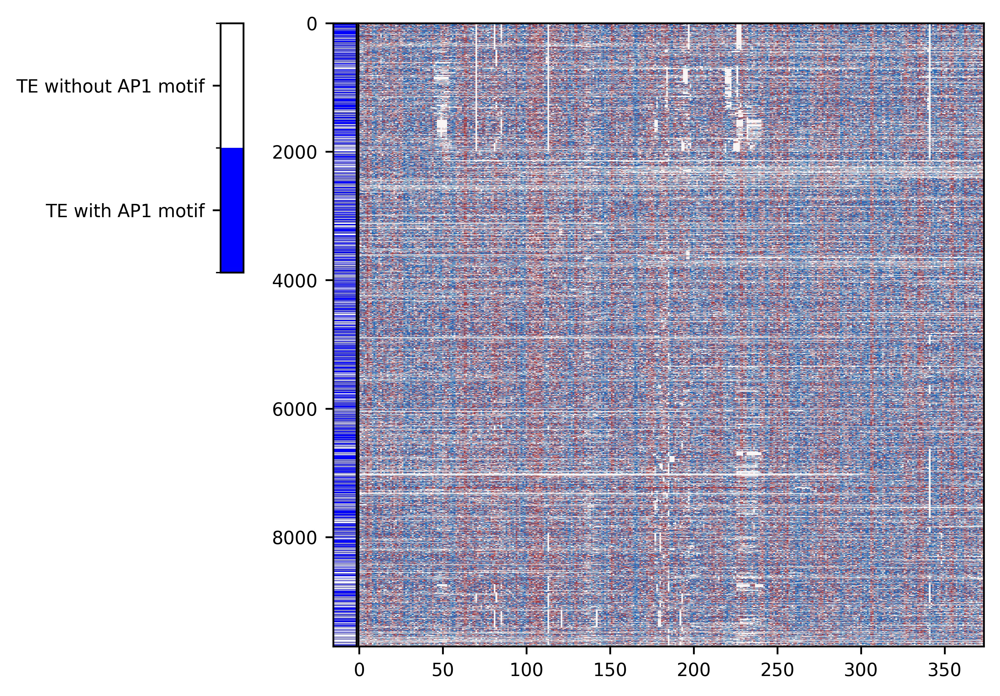

In [37]:
plots.plot(
    data=[phyloP_matrix], 
    heatmap_color=[custom_cmap.vlag_r_mpl], 
    vlim =[[-0.5,0.5]], 
    opacity=0.99, 
    annotation = True,  #enable annotation
    anno_col=[['blue','white']], #annotation colorset
    annotation_data= [ap1_motif_annotation], #annotation array
    anno_cbar_label=[['TE with AP1 motif', 'TE without AP1 motif']]) #annotation label

We can adjust label and title

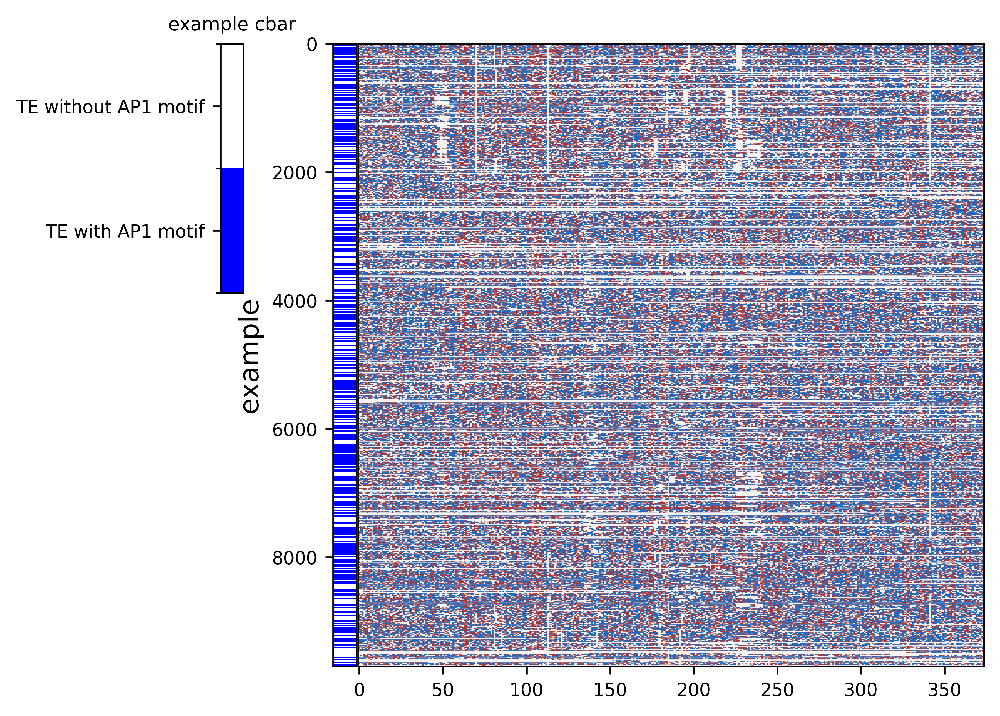

In [38]:
plots.plot(
    data=[phyloP_matrix], 
    heatmap_color=[custom_cmap.vlag_r_mpl], 
    vlim =[[-0.5,0.5]], 
    opacity=0.99, 
    annotation = True,  #enable annotation
    anno_col=[['blue','white']], #annotation colorset
    annotation_data= [ap1_motif_annotation], #annotation array
    anno_cbar_label=[['TE with AP1 motif', 'TE without AP1 motif']], #annotation label
    anno_ylabel='example',
    anno_ylabel_fs=12,
    anno_cbar = True,
    anno_cbar_title=['example cbar'],
)